In [1]:
import numpy as np
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
import sr3

In [2]:
import sr3.noise_utils
from sr3.noise_utils import *

2021-12-15 13:20:29.026000: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


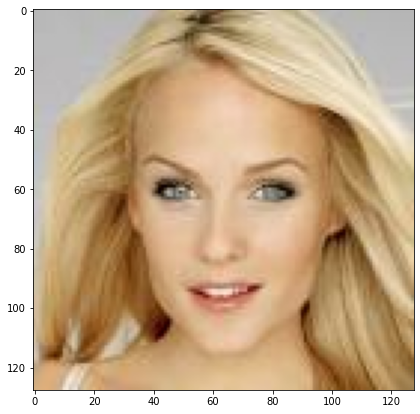

In [3]:
img = tf.io.decode_jpeg(tf.io.read_file("../resources/00002.jpg"))
img = tf.image.convert_image_dtype(img, tf.float32)
plt.figure(figsize=(7, 7))
plt.imshow(img.numpy())
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


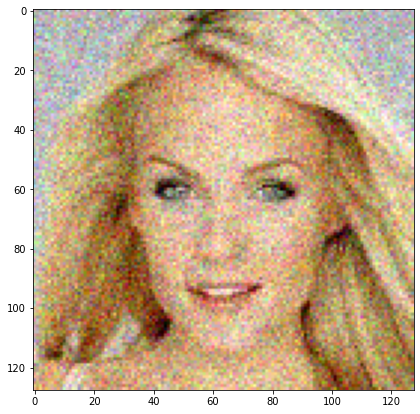

In [4]:
noisy_img = generate_noisy_image(img, 0.99)
plt.figure(figsize=(7, 7))
plt.imshow(noisy_img.numpy())
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


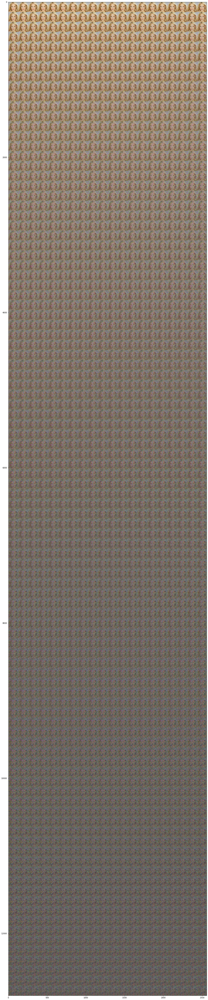

In [12]:
timesteps = 2000
ncols = 20
def gallery(array, ncols=ncols):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    # want result.shape = (height*nrows, width*ncols, intensity)
    result = (array.reshape(nrows, ncols, height, width, intensity)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols, intensity))
    return result

schedule = noise_schedule('const', 0.9987, 0.9987, timesteps)
noisy_imgs = [img]
for i in range(timesteps):
  noisy_img = generate_noisy_image(noisy_imgs[-1], tf.cast(schedule[i], tf.float32))
  noisy_imgs.append(noisy_img)
noisy_imgs = np.array(noisy_imgs[1:])
plt.figure(figsize=(ncols * 3, timesteps // ncols))
plt.imshow(gallery(noisy_imgs))
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


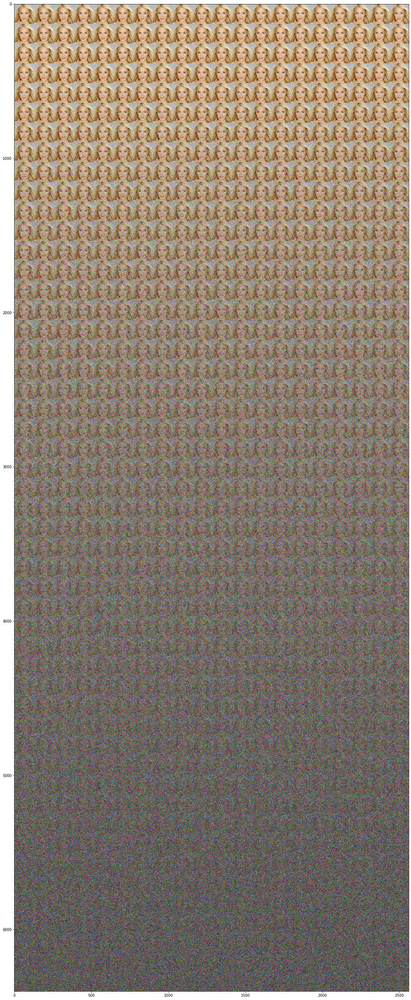

In [13]:
timesteps = 1000
ncols = 20
def gallery(array, ncols=ncols):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    # want result.shape = (height*nrows, width*ncols, intensity)
    result = (array.reshape(nrows, ncols, height, width, intensity)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols, intensity))
    return result

schedule = noise_schedule('quad', 1, 0.993, timesteps, gammas=True)
noisy_imgs = [img]
for i in range(timesteps):
  noisy_img = generate_noisy_image(img, tf.cast(schedule[i], tf.float32))
  noisy_imgs.append(noisy_img)
noisy_imgs = np.array(noisy_imgs[1:])
plt.figure(figsize=(ncols * 3, timesteps // ncols))
plt.imshow(gallery(noisy_imgs))
plt.show()

In [ ]:
print(tf.math.reduce_std(noisy_imgs, axis=(1, 2, 3)))
print(tf.math.reduce_std(img, axis=(0, 1, 2)))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


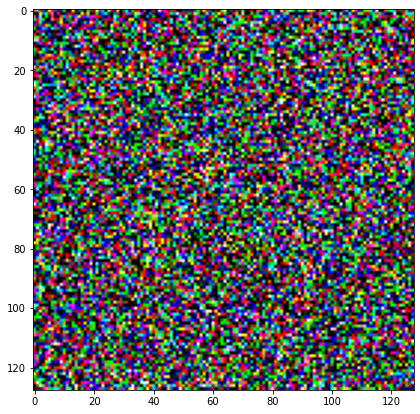

In [ ]:
full_noise_img = generate_noisy_image(tf.ones((128,128,3)), 0)
plt.figure(figsize=(7, 7))
plt.imshow(full_noise_img.numpy())
plt.show()